In [ ]:
!nvidia-smi

Fri Feb 19 15:34:20 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.39       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   67C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#Keras RetinaNet setup
importing the git repository

In [ ]:
!git clone https://github.com/fizyr/keras-retinanet.git

Cloning into 'keras-retinanet'...
remote: Enumerating objects: 6205, done.
remote: Total 6205 (delta 0), reused 0 (delta 0), pack-reused 6205
Receiving objects: 100% (6205/6205), 13.47 MiB | 16.17 MiB/s, done.
Resolving deltas: 100% (4199/4199), done.


upgrade keras to latest update

In [ ]:
!pip install keras==2.4

     |████████████████████████████████| 174kB 7.9MB/s 
  Found existing installation: Keras 2.4.3
    Uninstalling Keras-2.4.3:
      Successfully uninstalled Keras-2.4.3


In [ ]:
%cd keras-retinanet/
!pip install .

/content/keras-retinanet
Processing /content/keras-retinanet
  Created wheel for keras-retinanet: filename=keras_retinanet-1.0.0-cp36-cp36m-linux_x86_64.whl size=167029 sha256=843088b7a133fb50731dfa2e779191c5310e524b38cb47e40d0149802f9b61a5
  Stored in directory: /root/.cache/pip/wheels/b2/9f/57/cb0305f6f5a41fc3c11ad67b8cedfbe9127775b563337827ba
  Created wheel for keras-resnet: filename=keras_resnet-0.2.0-py2.py3-none-any.whl size=20486 sha256=4e0a9a8aa61670728a4baa53c46b6295b8b4830a56836657e52e94f5d0e76567
  Stored in directory: /root/.cache/pip/wheels/5f/09/a5/497a30fd9ad9964e98a1254d1e164bcd1b8a5eda36197ecb3c
Successfully built keras-retinanet keras-resnet


setup the model

In [ ]:
!python setup.py build_ext --inplace

running build_ext
cythoning keras_retinanet/utils/compute_overlap.pyx to keras_retinanet/utils/compute_overlap.c
/usr/local/lib/python3.6/dist-packages/Cython/Compiler/Main.py:369: FutureWarning: Cython directive 'language_level' not set, using 2 for now (Py2). This will change in a later release! File: /content/keras-retinanet/keras_retinanet/utils/compute_overlap.pyx
  tree = Parsing.p_module(s, pxd, full_module_name)
building 'keras_retinanet.utils.compute_overlap' extension
creating build
creating build/temp.linux-x86_64-3.6
creating build/temp.linux-x86_64-3.6/keras_retinanet
creating build/temp.linux-x86_64-3.6/keras_retinanet/utils
x86_64-linux-gnu-gcc -pthread -DNDEBUG -g -fwrapv -O2 -Wall -g -fstack-protector-strong -Wformat -Werror=format-security -Wdate-time -D_FORTIFY_SOURCE=2 -fPIC -I/usr/include/python3.6m -I/usr/local/lib/python3.6/dist-packages/numpy/core/include -c keras_retinanet/utils/compute_overlap.c -o build/temp.linux-x86_64-3.6/keras_retinanet/utils/compute_over

In [ ]:
!pip install tensorflow==2.3.0

     |████████████████████████████████| 320.4MB 41kB/s 
     |████████████████████████████████| 460kB 49.7MB/s 
     |████████████████████████████████| 20.1MB 1.1MB/s 
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: tensorflow-estimator 2.4.0
    Uninstalling tensorflow-estimator-2.4.0:
      Successfully uninstalled tensorflow-estimator-2.4.0
  Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
  Found existing installation: tensorflow 2.4.1
    Uninstalling tensorflow-2.4.1:
      Successfully uninstalled tensorflow-2.4.1


In [ ]:
!pip install gdown

In [ ]:
!pip install -U scikit-learn

     |████████████████████████████████| 22.2MB 51.3MB/s 
  Found existing installation: scikit-learn 0.22.2.post1
    Uninstalling scikit-learn-0.22.2.post1:
      Successfully uninstalled scikit-learn-0.22.2.post1


Usefull libraries

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import pandas as pd
import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters
from sklearn.model_selection import train_test_split
import urllib
import os
import csv
import cv2
import time
from PIL import Image

from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

%matplotlib inline
%config InlineBackend.figure_format='retina'

register_matplotlib_converters()
sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

print("Setup ready")



Setup ready


Upload dataset into a pands dataframe

In [ ]:
!gdown --id 1mOK2qtcY9oNiAhWbOgvj4v8e9FuqcGIB 
%cd snapshots/
!gdown --id 1-5LKbOpsGVLyOADF7W17LV5dTi6UVC-V

Downloading...
From: https://drive.google.com/uc?id=1mOK2qtcY9oNiAhWbOgvj4v8e9FuqcGIB
To: /content/keras-retinanet/imgs.zip
935MB [00:13, 67.6MB/s]
/content/keras-retinanet/snapshots
Downloading...
From: https://drive.google.com/uc?id=1-5LKbOpsGVLyOADF7W17LV5dTi6UVC-V
To: /content/keras-retinanet/snapshots/resnet50_csv_50.h5
437MB [00:06, 67.5MB/s]


In [ ]:
%cd ..
!unzip imgs.zip

/content/keras-retinanet
Archive:  imgs.zip
   creating: imgs/test/
  inflating: imgs/test/bookstore_video1_10020.jpg  
  inflating: imgs/test/bookstore_video1_10050.jpg  
  inflating: imgs/test/bookstore_video1_10080.jpg  
  inflating: imgs/test/bookstore_video1_10110.jpg  
  inflating: imgs/test/bookstore_video1_10140.jpg  
  inflating: imgs/test/bookstore_video1_10170.jpg  
  inflating: imgs/test/bookstore_video1_10200.jpg  
  inflating: imgs/test/bookstore_video1_10230.jpg  
  inflating: imgs/test/bookstore_video1_10260.jpg  
  inflating: imgs/test/bookstore_video1_10290.jpg  
  inflating: imgs/test/bookstore_video1_10320.jpg  
  inflating: imgs/test/bookstore_video1_10350.jpg  
  inflating: imgs/test/bookstore_video1_10380.jpg  
  inflating: imgs/test/bookstore_video1_10410.jpg  
  inflating: imgs/test/bookstore_video1_10440.jpg  
  inflating: imgs/test/bookstore_video1_10470.jpg  
  inflating: imgs/test/bookstore_video1_10500.jpg  
  inflating: imgs/test/bookstore_video1_10530.jp

In [ ]:
os.makedirs("snapshots", exist_ok=True)
%cd snapshots
!gdown --id 15xo9KwxAd6Rg4Cd9_X30O3Whm8zte1a_
!unzip resnet50_coco_best_v2.1.0.zip
%cd ..

/content/keras-retinanet/snapshots
Downloading...
From: https://drive.google.com/uc?id=15xo9KwxAd6Rg4Cd9_X30O3Whm8zte1a_
To: /content/keras-retinanet/snapshots/resnet50_coco_best_v2.1.0.zip
141MB [00:02, 64.4MB/s]
Archive:  resnet50_coco_best_v2.1.0.zip
  inflating: resnet50_coco_best_v2.1.0.h5  
/content/keras-retinanet


In [ ]:
%cd snapshots/
!gdown --id 1wDTEQwwVxDBZuG8CBlSuT4Xhjl4I7kar
%cd ..


/content/keras-retinanet/snapshots
Downloading...
From: https://drive.google.com/uc?id=1wDTEQwwVxDBZuG8CBlSuT4Xhjl4I7kar
To: /content/keras-retinanet/snapshots/resnet50_csv_66.h5
437MB [00:05, 75.9MB/s]
/content/keras-retinanet


In [ ]:
%cd keras-retinanet/

[Errno 2] No such file or directory: 'keras-retinanet/'
/content/keras-retinanet


In [ ]:
df = pd.read_csv('train_annotations.csv')
df.head()

,imgs/train/bookstore_video0_360.jpg,421,1026,448,1058,Person
0,imgs/train/gates_video3_960.jpg,268,734,356,846,Person
1,imgs/train/bookstore_video0_12560.jpg,96,457,134,505,Person
2,imgs/train/gates_video3_120.jpg,149,137,179,196,Person
3,imgs/train/gates_video3_3000.jpg,171,809,264,900,Person
4,imgs/train/bookstore_video0_8000.jpg,357,976,391,1010,Person


In [ ]:
os.makedirs("humans", exist_ok=True)
df2 = pd.DataFrame(df)

#Training phase


In [ ]:
train_df, test_df = train_test_split(df2, test_size=0.000001, random_state=RANDOM_SEED)
train_df.head()

,imgs/train/bookstore_video0_360.jpg,421,1026,448,1058,Person
900,imgs/train/gates_video3_2600.jpg,658,1034,761,1146,Person
413,imgs/train/hyang_video5_4000.jpg,985,958,1037,1049,Person
467,imgs/train/hyang_video5_1600.jpg,397,759,478,821,Person
746,imgs/train/coupa_video1_1840.jpg,418,878,478,940,Person
109,imgs/train/deathCircle_video0_7000.jpg,934,1343,959,1379,Person


In [ ]:
test_df

,imgs/train/bookstore_video0_360.jpg,421,1026,448,1058,Person
784,imgs/train/deathCircle_video0_9720.jpg,785,1294,837,1355,Person


In [ ]:
ANNOTATIOS_FILE = 'train_annotations.csv'
CLASSES_FILE = 'classes.csv'

train_df.to_csv(ANNOTATIOS_FILE,index=False, header=None)

classes = set(['Person','Car'])

with open(CLASSES_FILE, 'w') as f:
	for i, line in enumerate(sorted(classes)):
		f.write('{}, {}\n'.format(line,i))

In [ ]:
!head classes.csv

Car, 0
Person, 1


In [ ]:
!gdown --id 1yUM8z0-Ogc18QCc2KROJFaGYmTYeZhlA
% cd ..

Downloading...
From: https://drive.google.com/uc?id=1yUM8z0-Ogc18QCc2KROJFaGYmTYeZhlA
To: /content/keras-retinanet/resnet50_csv_12_inference.h5
147MB [00:02, 57.1MB/s]
/content


In [ ]:
!wc -l train_annotations.csv

1134 train_annotations.csv


In [ ]:
!keras_retinanet/bin/debug.py --show-annotations csv train_annotations.csv classes.csv 

2021-02-09 23:01:41.437010: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
: cannot connect to X server 


Train the RetinaNet using own dataset

In [ ]:
!keras_retinanet/bin/train.py --help

2021-02-17 21:33:35.062465: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
usage: train.py [-h]
                [--snapshot SNAPSHOT | --imagenet-weights | --weights WEIGHTS | --no-weights]
                [--backbone BACKBONE] [--batch-size BATCH_SIZE] [--gpu GPU]
                [--multi-gpu MULTI_GPU] [--multi-gpu-force]
                [--initial-epoch INITIAL_EPOCH] [--epochs EPOCHS]
                [--steps STEPS] [--lr LR]
                [--optimizer-clipnorm OPTIMIZER_CLIPNORM]
                [--snapshot-path SNAPSHOT_PATH]
                [--tensorboard-dir TENSORBOARD_DIR]
                [--tensorboard-freq TENSORBOARD_FREQ] [--no-snapshots]
                [--no-evaluation] [--freeze-backbone] [--random-transform]
                [--image-min-side IMAGE_MIN_SIDE]
                [--image-max-side IMAGE_MAX_SIDE] [--no-resize]
                [--config CONFIG] [--weighted-average] [--compute-val-loss]
 

In [ ]:
!keras_retinanet/bin/train.py --snapshot snapshots/resnet50_csv_50.h5 \
--initial-epoch 50 \
--config config.ini \
--epochs 60 \
--step 428 \
--batch-size 2 \
csv train_annotations.csv classes.csv 

2021-02-17 23:23:43.098295: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Loading model, this may take a second...
2021-02-17 23:23:45.086522: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-17 23:23:45.115450: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-17 23:23:45.116135: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-02-17 23:23:45.116191: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
202

In [ ]:
!keras_retinanet/bin/train.py --snapshot snapshots/resnet50_csv_40.h5 \
--initial-epoch 40 \
--config config.ini \
--epochs 50 \
--step 428 \
--batch-size 2 \
csv train_annotations.csv classes.csv 

2021-02-17 21:35:02.895881: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Loading model, this may take a second...
2021-02-17 21:35:04.901227: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-17 21:35:04.930259: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-17 21:35:04.931003: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-02-17 21:35:04.931046: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
202

In [ ]:
!keras_retinanet/bin/train.py \
--weights snapshots/resnet50_coco_best_v2.1.0.h5 \
--config config.ini \
--epochs 40 \
--steps 428 \
--batch-size 2 \
csv train_annotations.csv classes.csv 

2021-02-17 14:27:48.045431: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Creating model, this may take a second...
2021-02-17 14:27:49.728495: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-17 14:27:49.756368: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-17 14:27:49.757123: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-02-17 14:27:49.757166: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
20

#Inference model

In [ ]:
%cd keras-retinanet/

/content/keras-retinanet


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

KeyboardInterrupt: ignored

In [ ]:
!cp -r /content/keras-retinanet/snapshots/resnet50_csv_50.h5 /content/gdrive/MyDrive/HereIdiot/


In [ ]:
%ls

build/           humans/   keras_retinanet/  setup.cfg   train_annotations.csv
classes.csv      images/   LICENSE           setup.py    val_annotations.csv
CONTRIBUTORS.md  imgs/     README.md         snapshots/
examples/        imgs.zip  requirements.txt  tests/


In [ ]:
!keras_retinanet/bin/convert_model.py --help

2021-02-18 15:31:40.438234: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
usage: convert_model.py [-h] [--backbone BACKBONE] [--no-nms]
                        [--no-class-specific-filter] [--config CONFIG]
                        [--nms-threshold NMS_THRESHOLD]
                        [--score-threshold SCORE_THRESHOLD]
                        [--max-detections MAX_DETECTIONS]
                        [--parallel-iterations PARALLEL_ITERATIONS]
                        model_in model_out

Script for converting a training model to an inference model.

positional arguments:
  model_in              The model to convert.
  model_out             Path to save the converted model to.

optional arguments:
  -h, --help            show this help message and exit
  --backbone BACKBONE   The backbone of the model to convert.
  --no-nms              Disables non maximum suppression.
  --no-class-specific-filter
                 

In [ ]:
!keras_retinanet/bin/convert_model.py --config config.ini snapshots/resnet50_csv_50.h5 snapshots/inference_50.h5 

2021-02-19 15:46:46.642841: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-02-19 15:46:47.894828: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-19 15:46:47.929888: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-19 15:46:47.930462: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-19 15:46:47.930510: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-02-19 15:46:47.932229: I tensorflow/stream_executor/platform/default

In [ ]:
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
from tensorflow import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from keras_retinanet.utils.gpu import setup_gpu

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time
import tensorflow.keras.backend
# use this to change which GPU to use
# gpu = 0

# # set the modified tf session as backend in keras
# setup_gpu(gpu)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
model_path = os.path.join('snapshots', sorted(os.listdir('snapshots'), reverse=True)[0])
print(model_path)

snapshots/resnet50_csv_50.h5


#Compilation of the model

In [ ]:
import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
from keras_retinanet.utils.gpu import setup_gpu


model_path = os.path.join( 'snapshots', 'inference_50.h5')
model = models.load_model(model_path, backbone_name='resnet50')
# model = models.convert_model(model)
# keras_retinanet.models.backbone('resnet50').retinanet(num_classes=1)
# model.compile(
#     loss={
#         'regression'    : keras_retinanet.losses.smooth_l1(),
#         'classification': keras_retinanet.losses.focal()
#     },
#     optimizer=keras.optimizers.Adam(lr=1e-5, clipnorm=0.001),
#     metrics=['accuracy']
# )

# labels_to_names = pd.read_csv(CLASSES_FILE, header=None).T.loc[0].to_dict()
labels_to_names ={0: 'Car', 1: 'Person'}
print(labels_to_names)


{0: 'Car', 1: 'Person'}


#Run model on an image

855
processing time:  0.1820979118347168


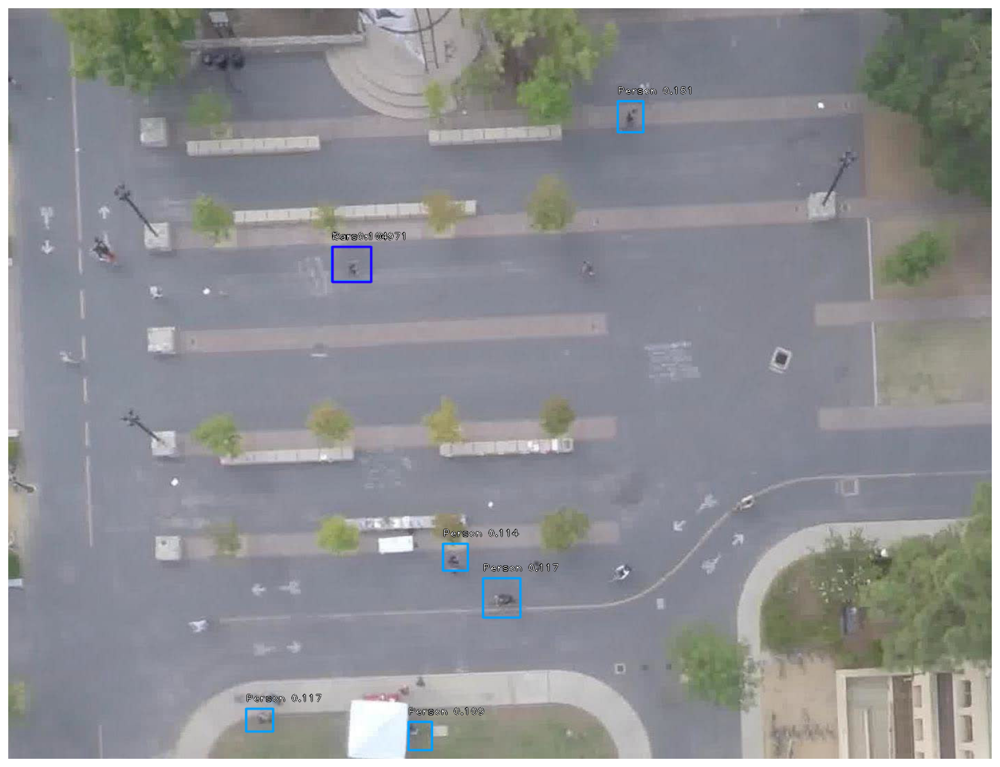

processing time:  0.1475505828857422


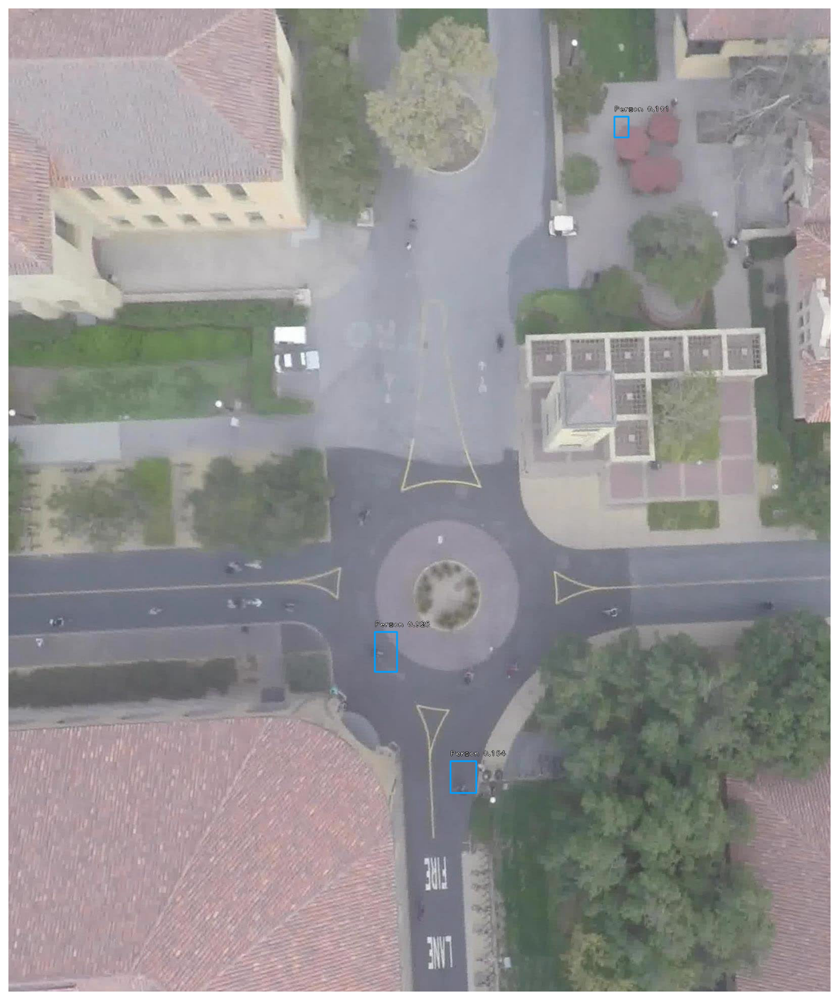

processing time:  0.20760202407836914


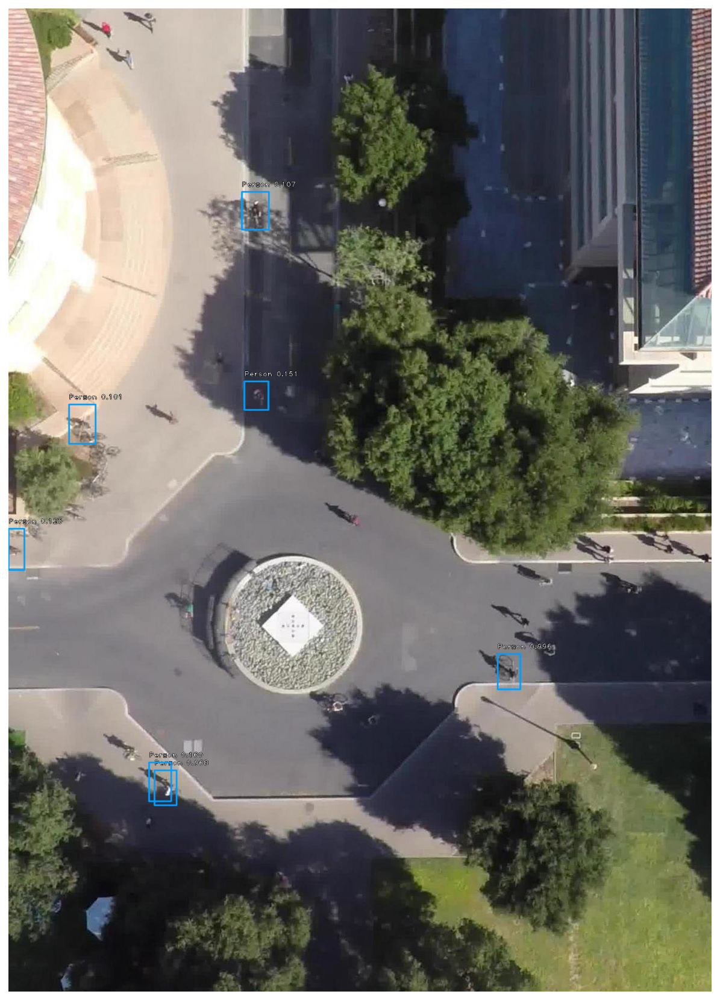

processing time:  0.13844871520996094


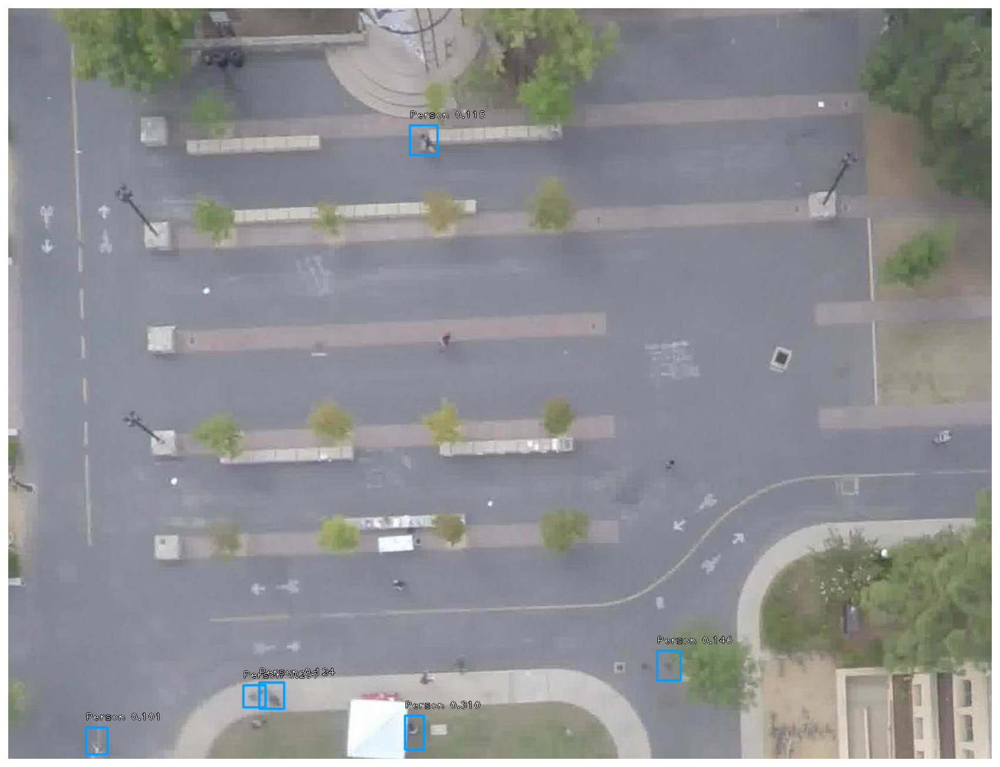

processing time:  0.13973355293273926


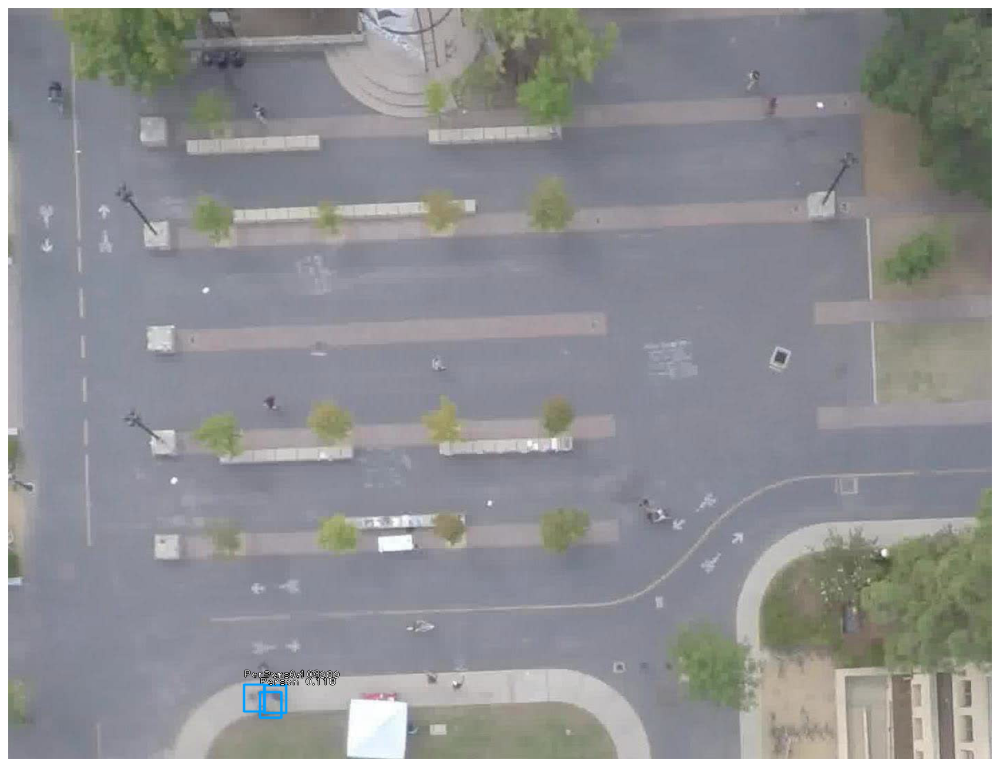

processing time:  0.136091947555542


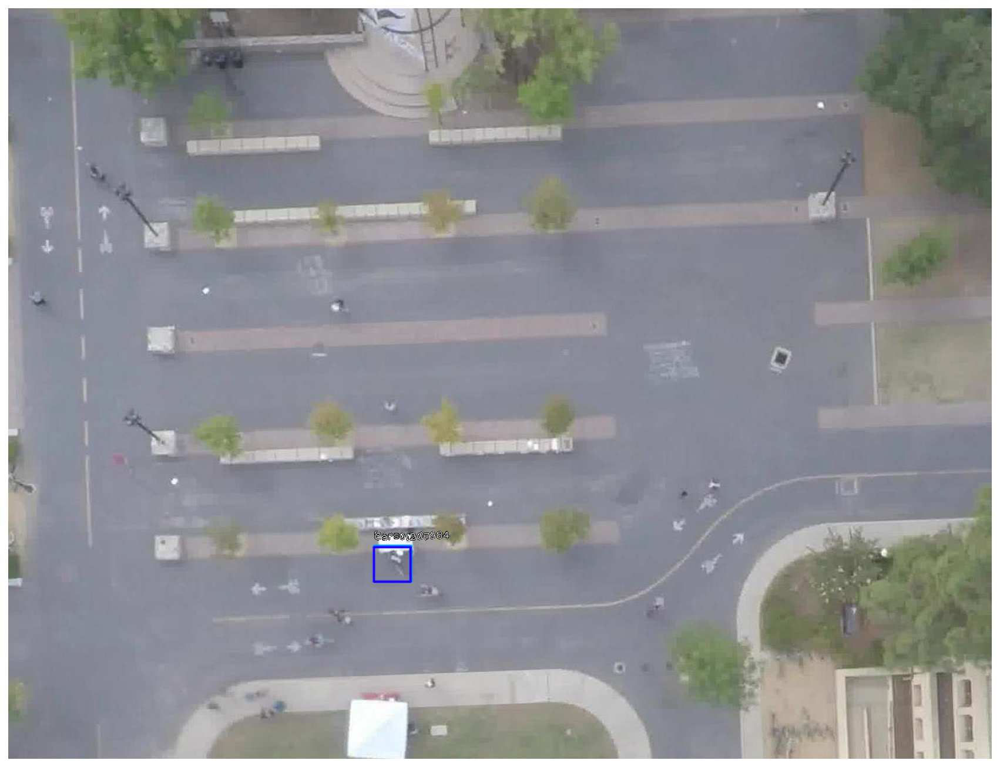

processing time:  0.1424551010131836


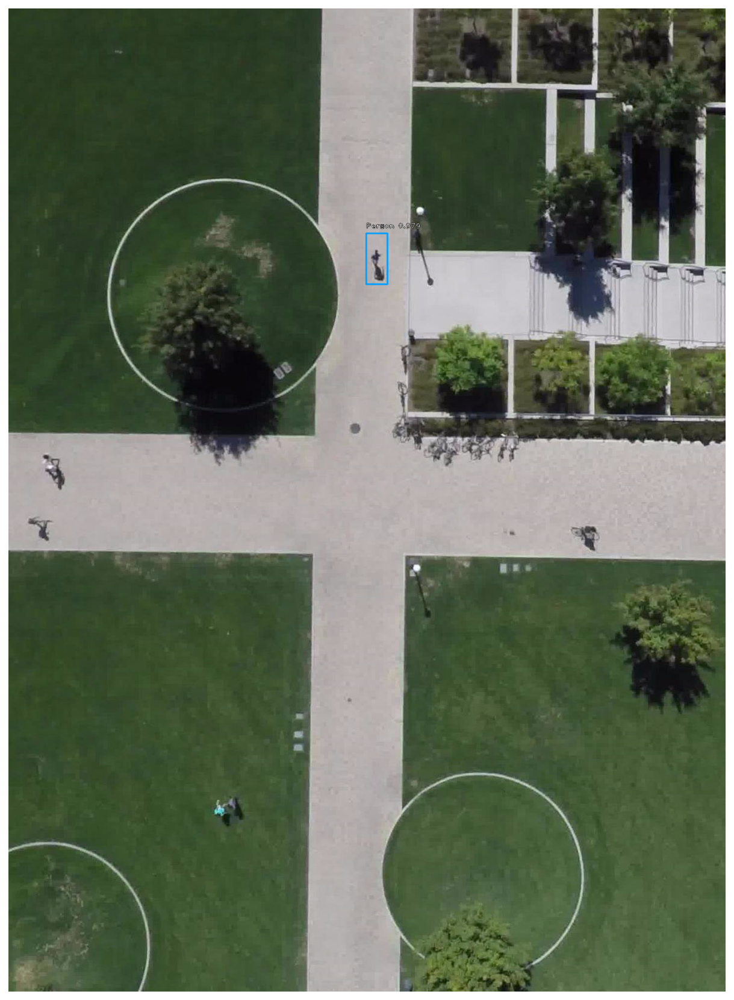

processing time:  0.1256556510925293


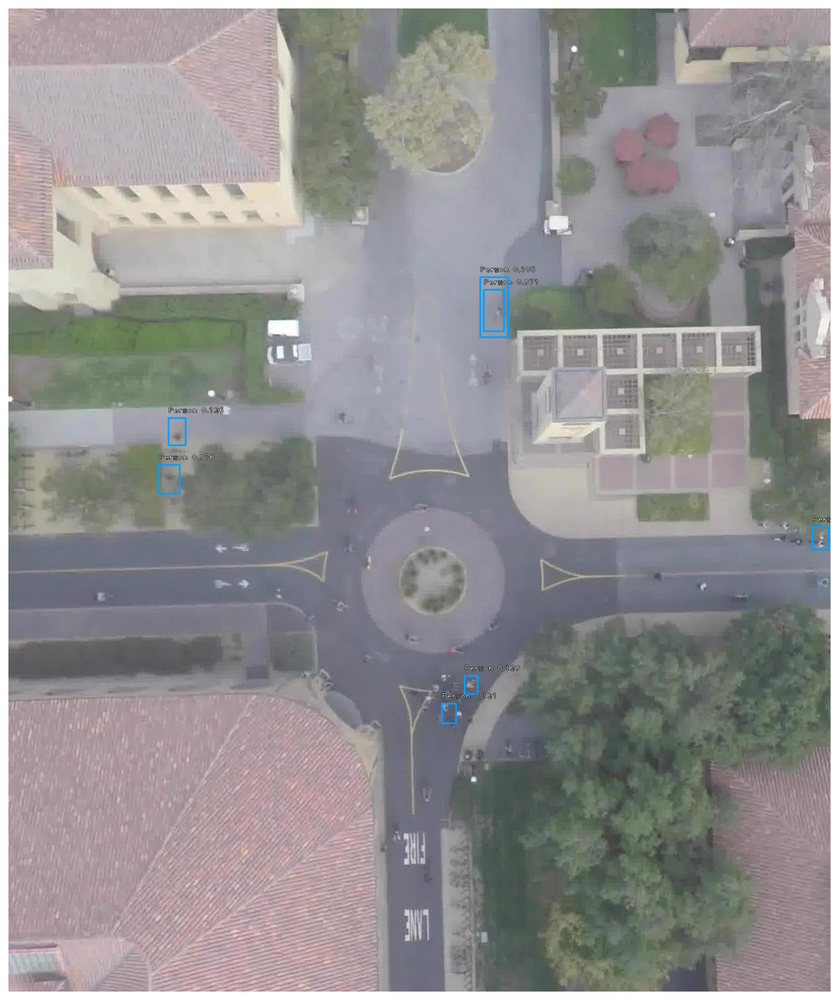

processing time:  0.18842029571533203


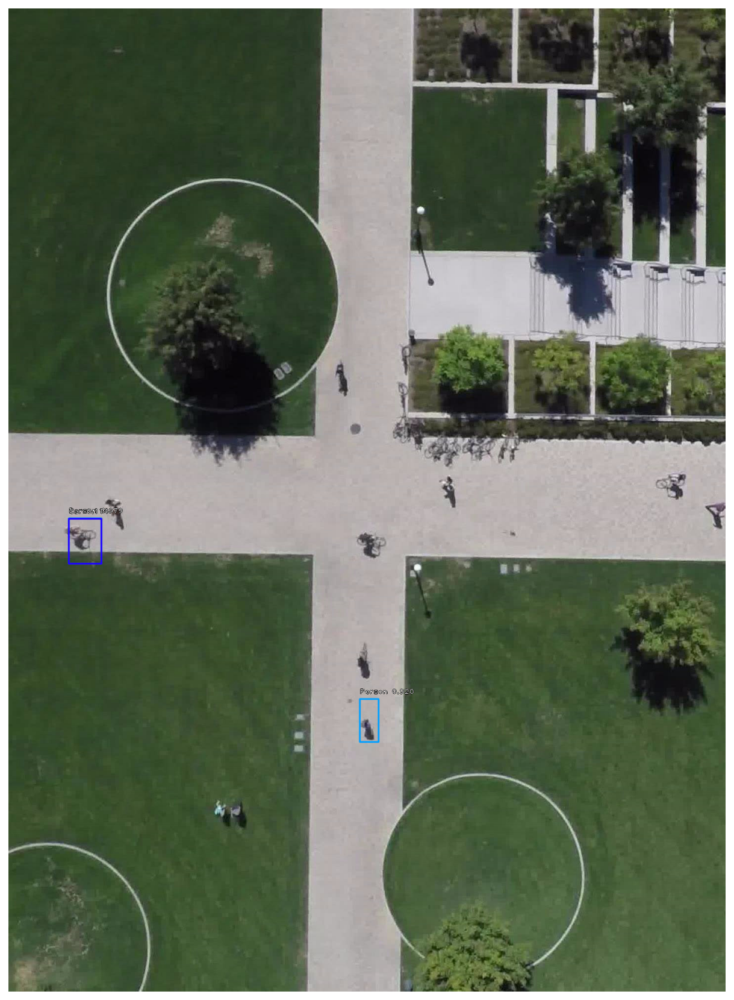

processing time:  0.16001057624816895


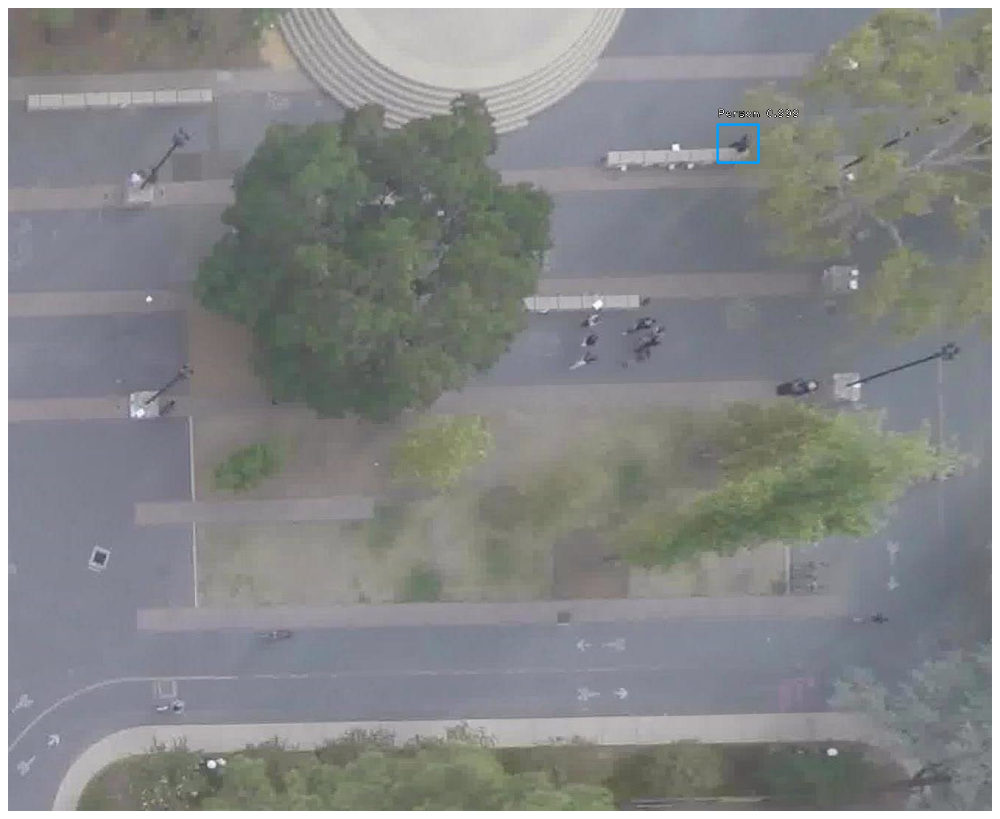

processing time:  0.254990816116333


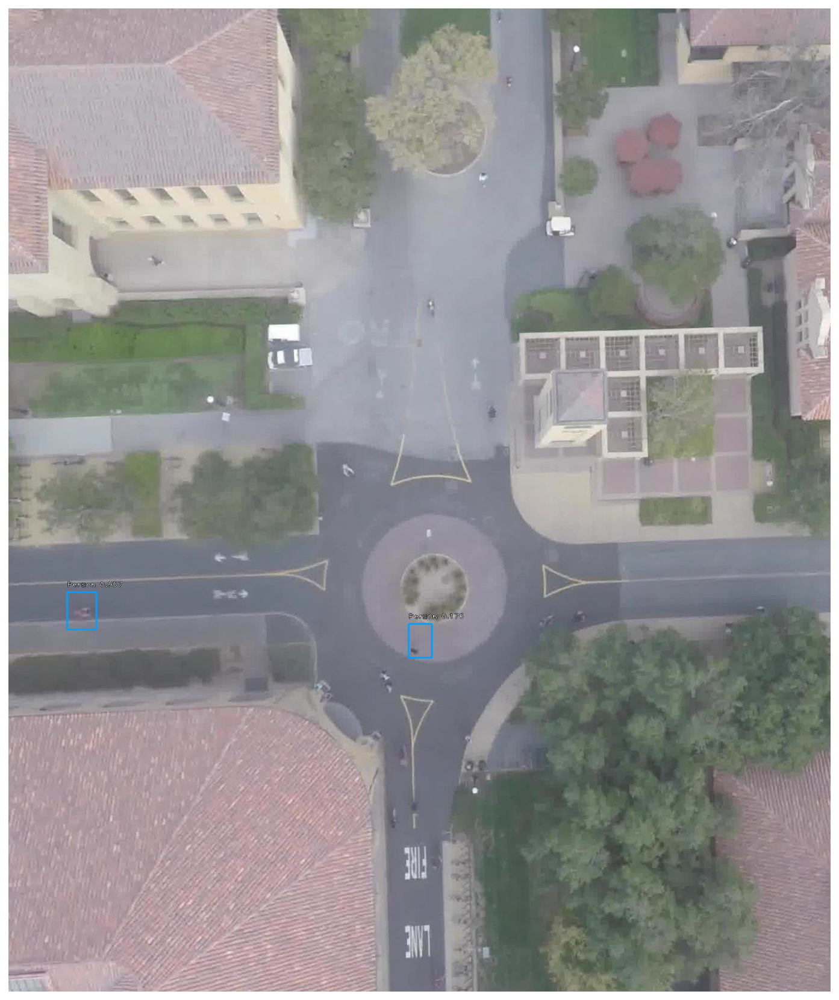

processing time:  0.21484375


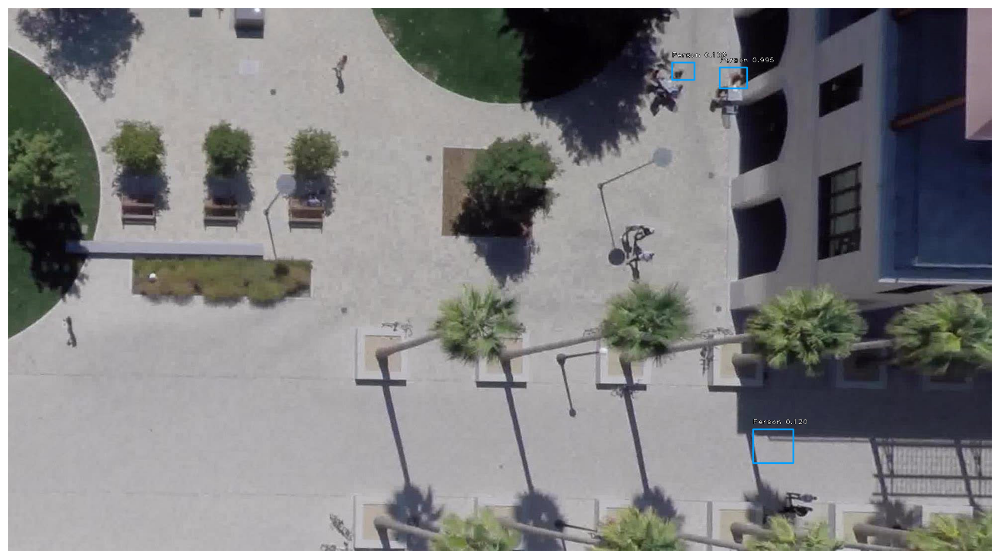

processing time:  0.17562580108642578


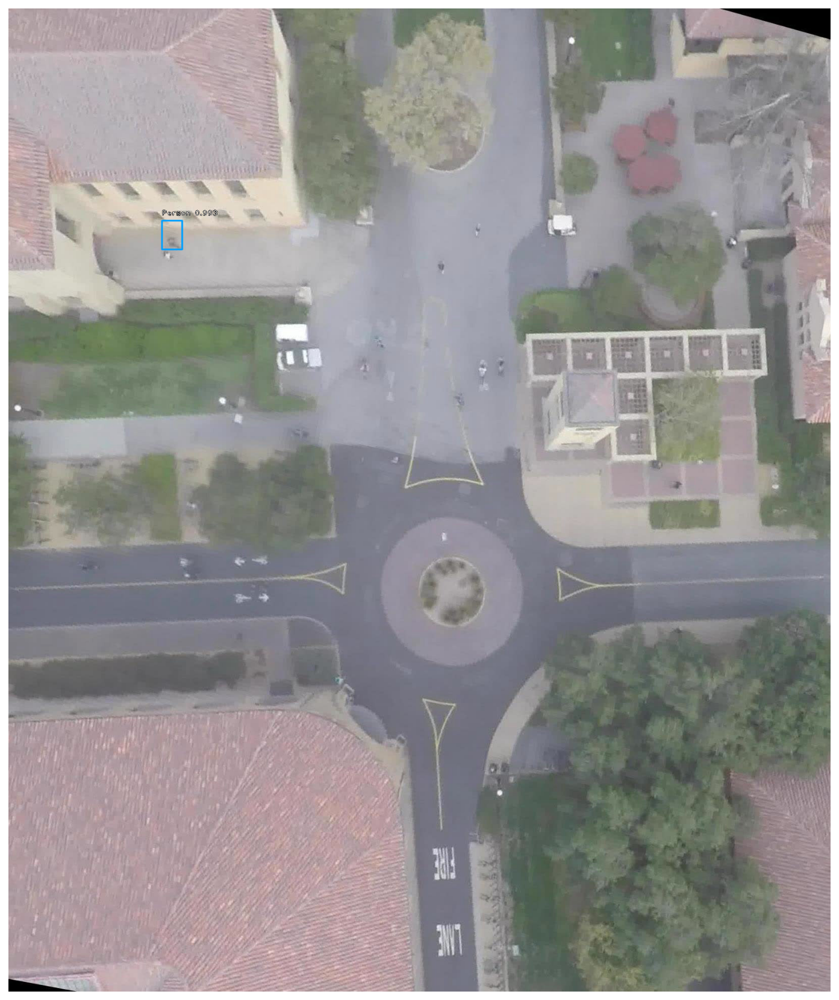

processing time:  0.2061786651611328


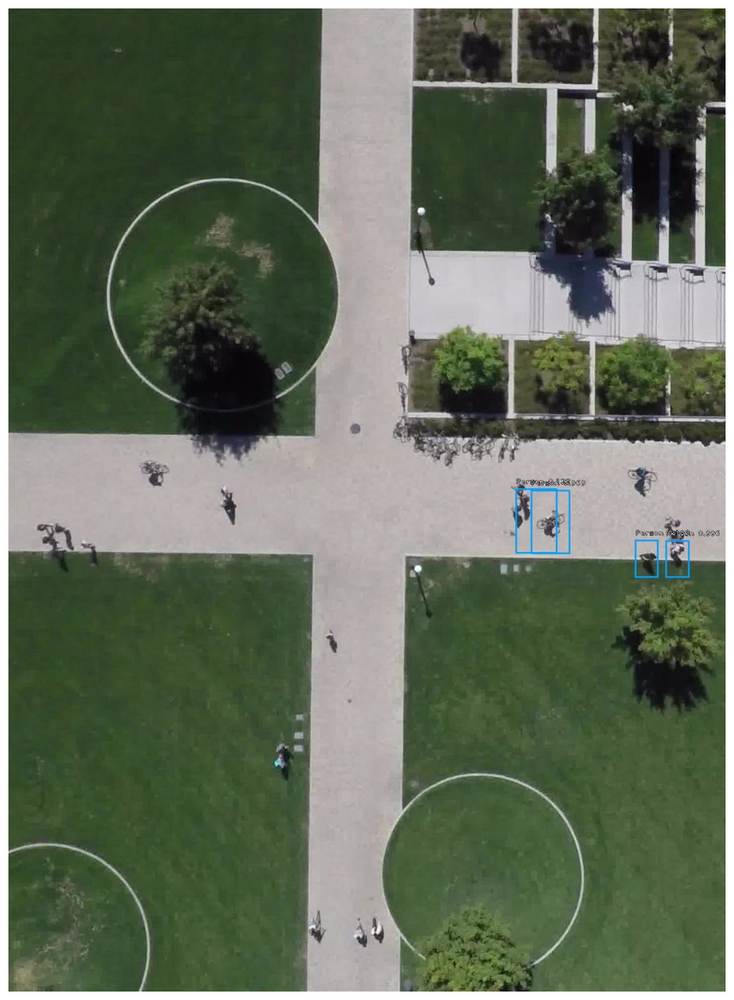

processing time:  0.19467854499816895


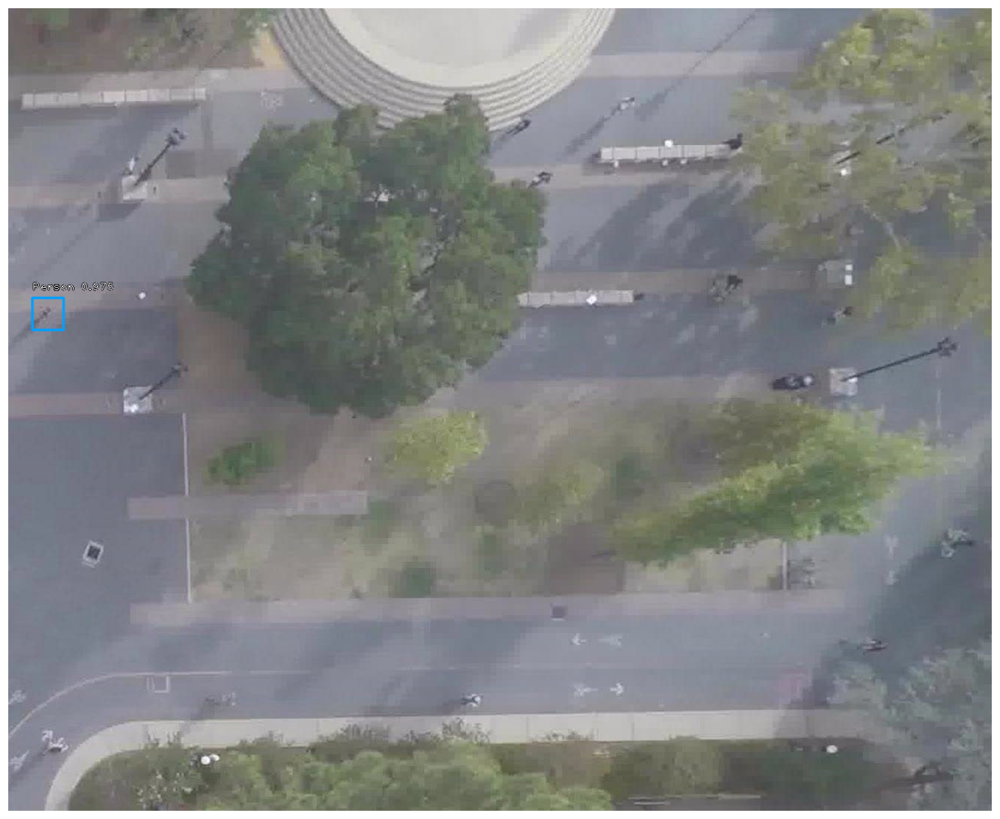

processing time:  0.15894770622253418


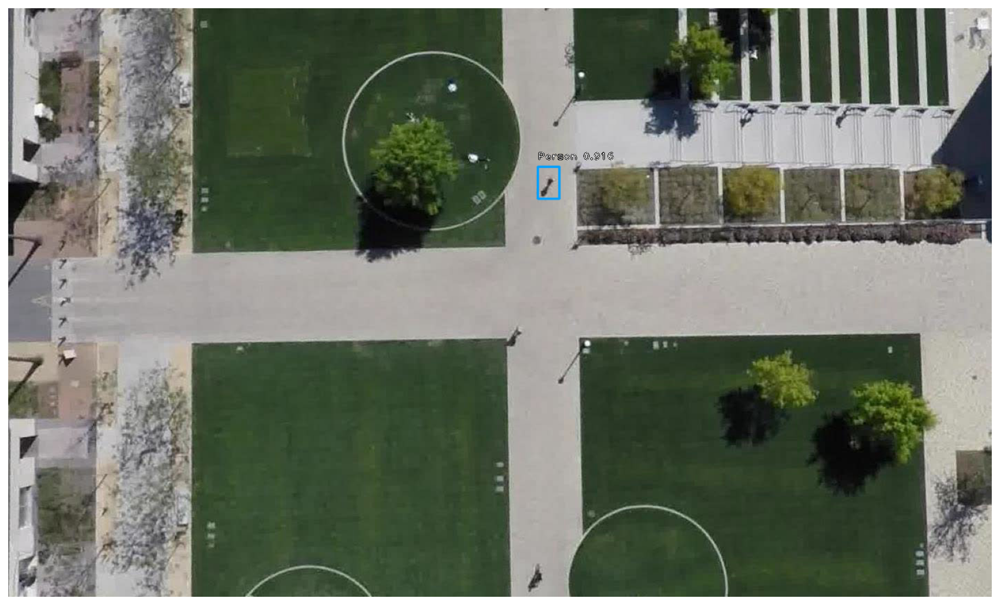

processing time:  0.1361227035522461


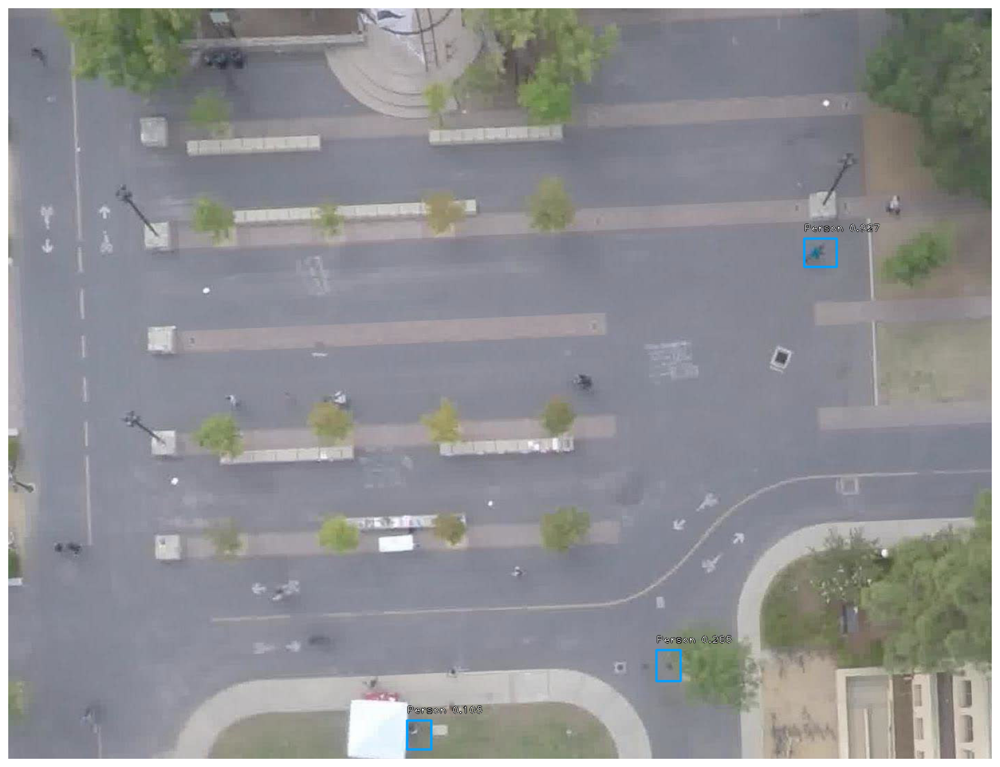

processing time:  0.14031982421875


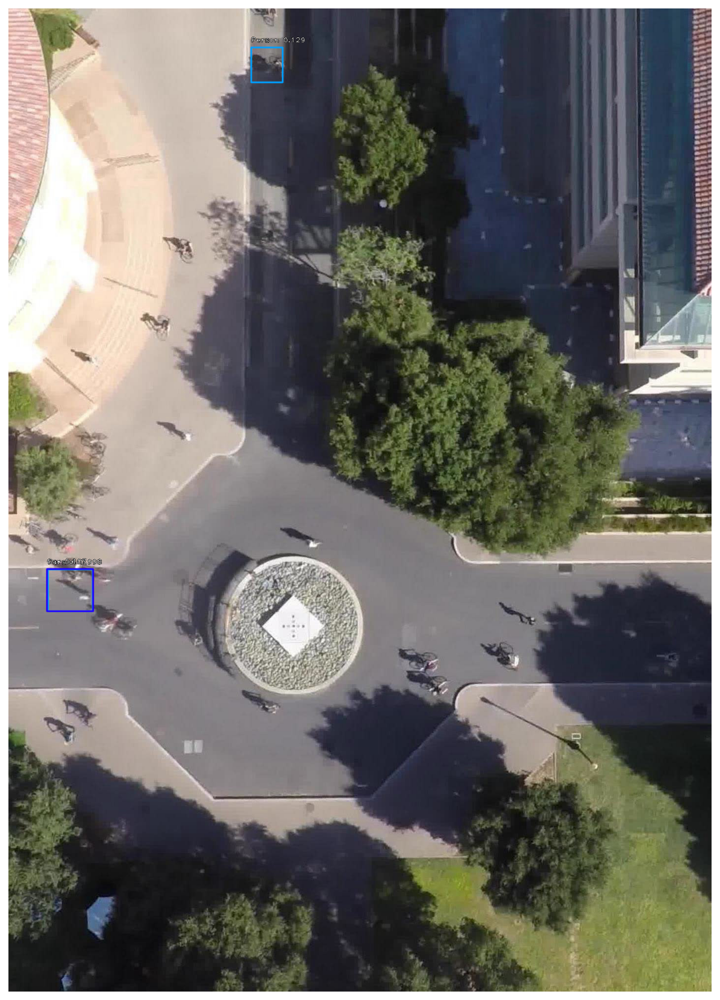

processing time:  0.20003437995910645


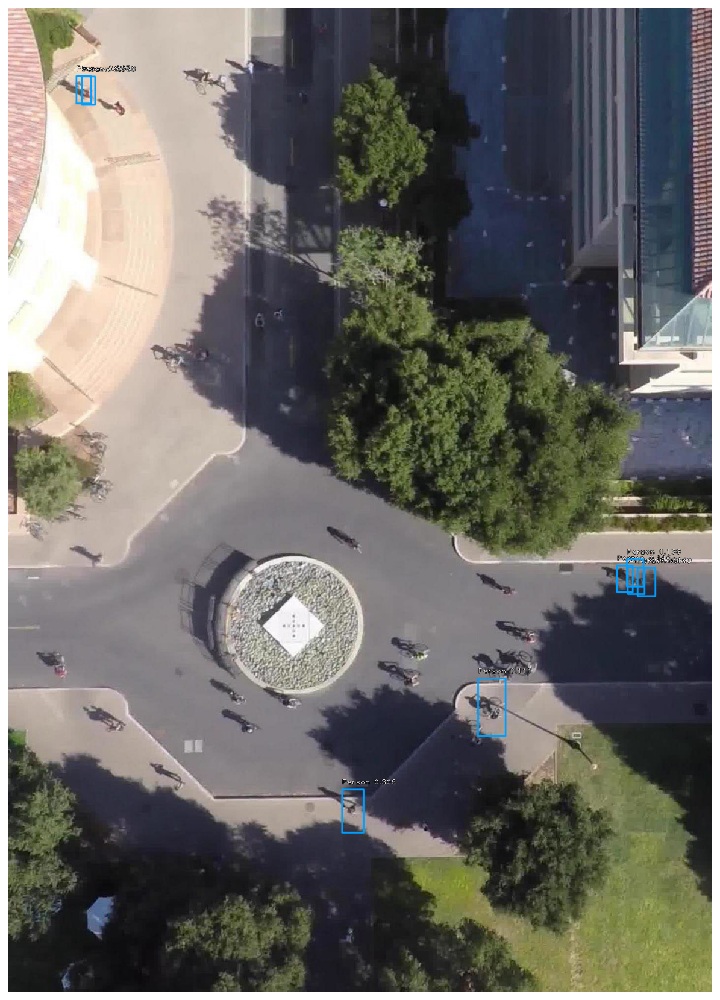

processing time:  0.18113994598388672


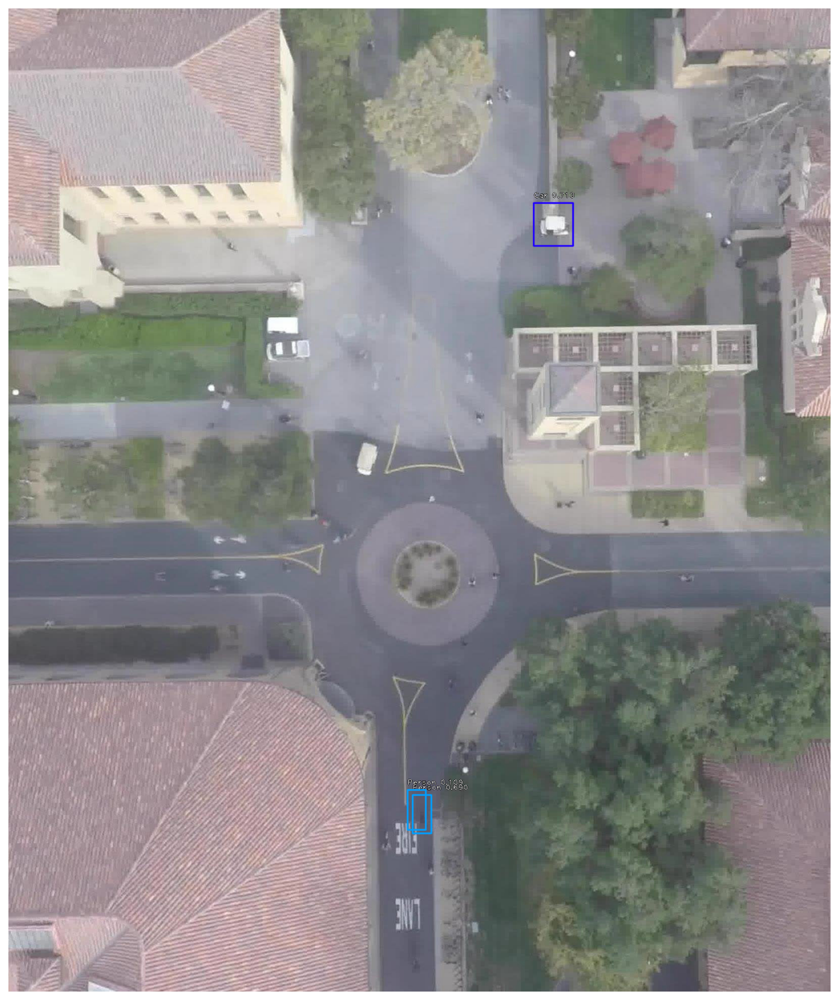

processing time:  0.1761622428894043


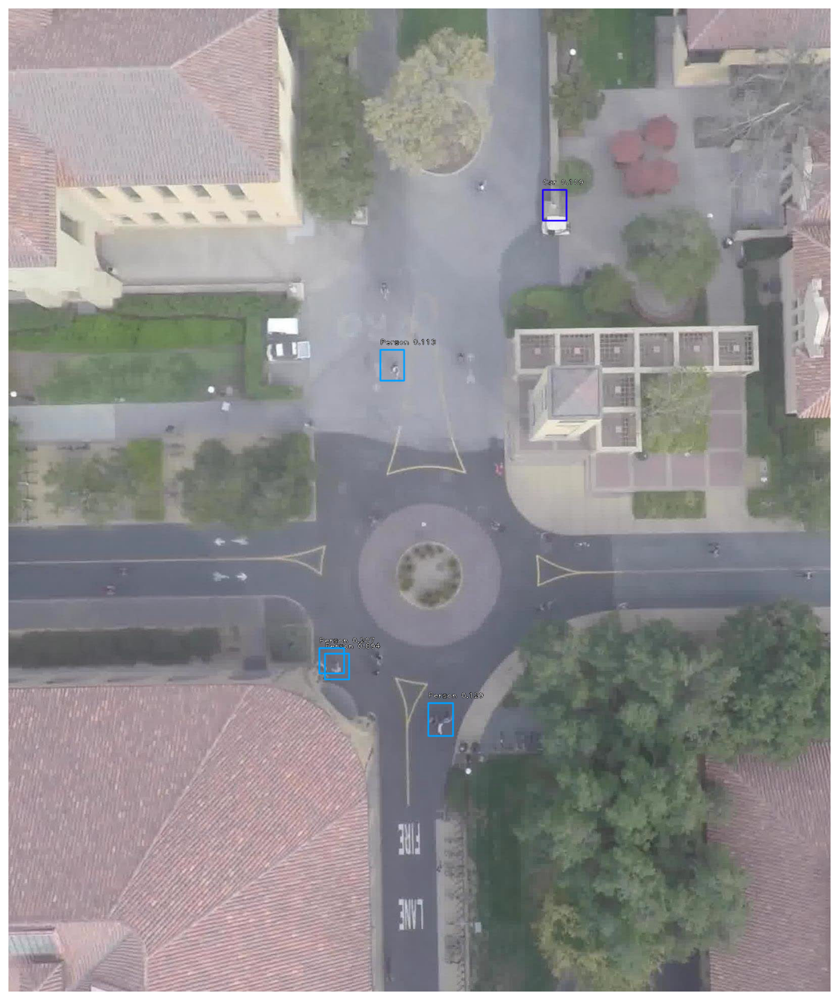

processing time:  0.2015833854675293


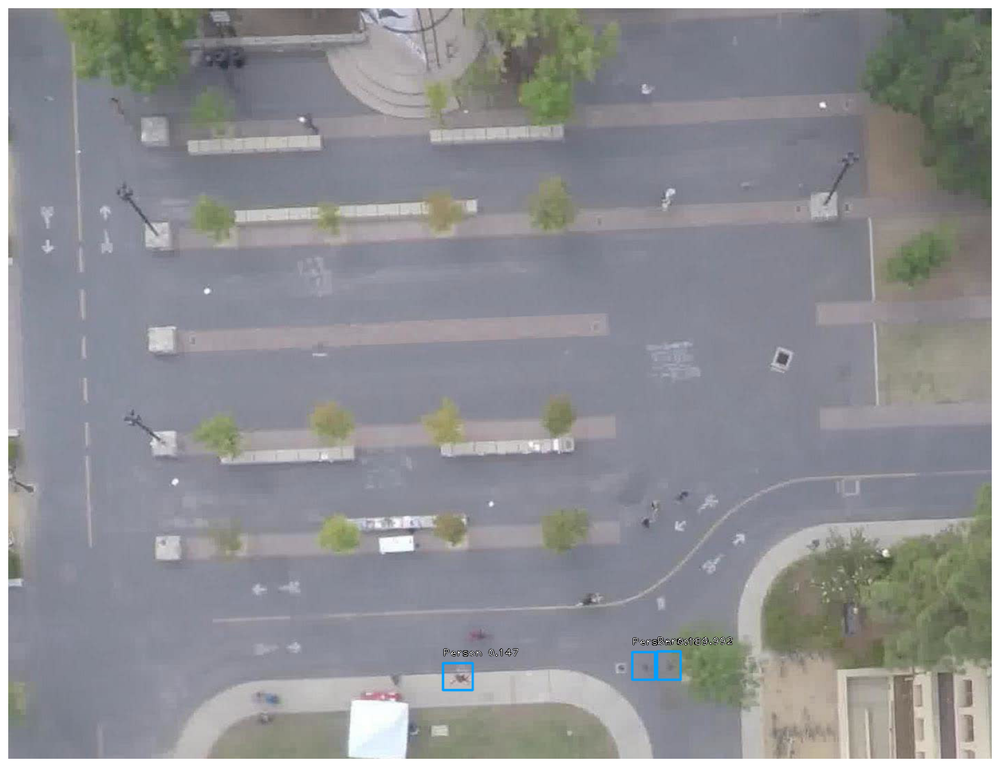

processing time:  0.20891618728637695


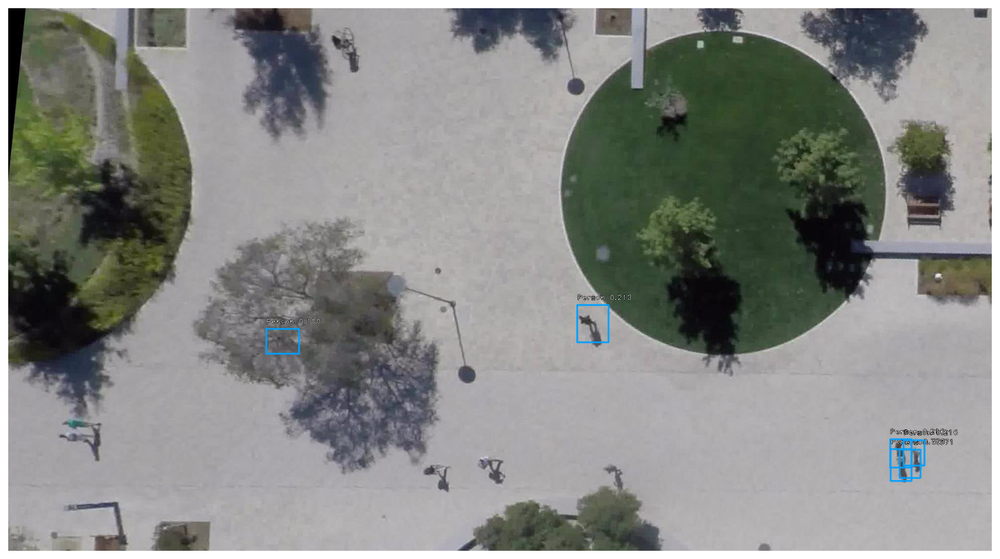

processing time:  0.15841960906982422


KeyboardInterrupt: ignored

In [ ]:
annotations_file = 'train_annotations.csv'
cwd = os.getcwd()

image_names = []

with open (os.path.join(cwd, annotations_file)) as csvfile:
    readCSV = csv.reader(csvfile, delimiter='\n')
    for row in readCSV:
        vals = row[0].split(',')
        this_filepath = vals[0]
        image_names.append(this_filepath)
        
## remove duplicates by taking a set
imagePaths = list(set(image_names))
print(len(imagePaths))

LABELS = open('classes.csv').read().strip().split('\n')
LABELS = {int(L.split(",")[1]): L.split(",")[0] for L in LABELS}

for(i, imagePath) in enumerate(imagePaths):
  
  filename = (imagePath.split(os.path.sep)[-1]).split('.')[0]
  output_file = os.path.sep.join(['humans', '{}.txt'.format(filename)])
  file = open(output_file, 'w')

  image = read_image_bgr(imagePath )#('imgs/test/bookstore_video1_10290.jpg')

  # copy to draw on
  draw = image.copy()
  draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

  # preprocess image for network
  image = preprocess_image(image)
  image, scale = resize_image(image)

  # process image
  start = time.time()
  (boxes, scores, labels) = model.predict(np.expand_dims(image, axis=0))
  print("processing time: ", time.time() - start)

  # correct for image scale
  boxes /= scale

  # visualize detections
  for box, score, label in zip(boxes[0], scores[0], labels[0]):
      # scores are sorted so we can break
      if score < 0.1:
          break
          
      color = label_color(label)
      
      b = box.astype(int)
      row = " ".join([LABELS[label], str(score),
                        str(box[1]), str(box[0]), str(box[3]), str(box[2])])
      file.write("{}\n".format(row))
      draw_box(draw, b, color=color)
      
      caption = "{} {:.3f}".format(labels_to_names[label], score)
      draw_caption(draw, b, caption)
      
  file.close()
  plt.figure(figsize=(15, 15))
  plt.axis('off')
  plt.imshow(draw)
  plt.show()

In [ ]:
!python keras_retinanet/bin/evaluate.py --help

In [ ]:
!python keras_retinanet/bin/evaluate.py --config config.ini --iou-threshold 0.3 csv train_annotations.csv classes.csv snapshots/resnet50_csv_50.h5 --convert-model

2021-02-19 15:41:06.493287: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Loading model, this may take a second...
2021-02-19 15:41:08.237544: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-19 15:41:08.299072: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-19 15:41:08.299678: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-19 15:41:08.299730: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-0

In [ ]:
!python keras_retinanet/bin/evaluate.py --config config.ini --iou-threshold 0.3 csv test_annotations.csv classes.csv snapshots/resnet50_csv_50.h5 --convert-model

2021-02-19 15:44:05.347363: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Loading model, this may take a second...
2021-02-19 15:44:07.018460: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-19 15:44:07.051911: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-19 15:44:07.052480: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-19 15:44:07.052532: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-0

In [ ]:
!python keras_retinanet/bin/evaluate.py --config config.ini --iou-threshold 0.6 csv test_annotations.csv classes.csv snapshots/resnet50_csv_50.h5 --convert-model

2021-02-18 17:57:20.204347: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Using TensorFlow backend.
Loading model, this may take a second...
2021-02-18 17:57:21.737102: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcuda.so.1
2021-02-18 17:57:21.742788: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:982] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-18 17:57:21.743203: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1716] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.75GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-18 17:57:21.743238: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
2021-0

In [ ]:
test_df

,imgs/train/bookstore_video0_360.jpg,421,1026,448,1058,Person
784,imgs/train/deathCircle_video0_9720.jpg,785,1294,837,1355,Person
900,imgs/train/gates_video3_2600.jpg,658,1034,761,1146,Person
413,imgs/train/hyang_video5_4000.jpg,985,958,1037,1049,Person
467,imgs/train/hyang_video5_1600.jpg,397,759,478,821,Person
746,imgs/train/coupa_video1_1840.jpg,418,878,478,940,Person
...,...,...,...,...,...,...
334,imgs/train/coupa_video2_9920.jpg,695,1045,761,1090,Person
714,imgs/train/bookstore_video3_2040.jpg,189,395,238,445,Person
834,imgs/train/coupa_video1_4600.jpg,1762,168,1815,204,Person
677,imgs/train/deathCircle_video0_6440.jpg,633,1233,667,1298,Person


In [ ]:
annotations_file = 'test_annotations.csv'
cwd = os.getcwd()

image_names = []

with open (os.path.join(cwd, annotations_file)) as csvfile:
    readCSV = csv.reader(csvfile, delimiter='\n')
    for row in readCSV:
        vals = row[0].split(',')
        this_filepath = vals[0]
        image_names.append(this_filepath)
        
## remove duplicates by taking a set
image_names = list(set(image_names))
print(len(image_names))

325


In [ ]:
(image_names[:])

['imgs/train/gates_video3_4440.jpg',
 'imgs/train/bookstore_video0_2280.jpg',
 'imgs/train/hyang_video5_3480.jpg',
 'imgs/train/gates_video3_2280.jpg',
 'imgs/train/bookstore_video0_12560.jpg',
 'imgs/train/bookstore_video0_8040.jpg',
 'imgs/train/bookstore_video0_7440.jpg',
 'imgs/train/coupa_video2_4440.jpg',
 'imgs/train/hyang_video5_8120.jpg',
 'imgs/train/hyang_video6_6240.jpg',
 'imgs/train/bookstore_video3_13840.jpg',
 'imgs/train/bookstore_video3_7800.jpg',
 'imgs/train/deathCircle_video0_6840.jpg',
 'imgs/train/bookstore_video0_4200.jpg',
 'imgs/train/deathCircle_video0_7560.jpg',
 'imgs/train/coupa_video2_3280.jpg',
 'imgs/train/deathCircle_video0_2080.jpg',
 'imgs/train/bookstore_video3_1800.jpg',
 'imgs/train/little_video0_360.jpg',
 'imgs/train/hyang_video6_4760.jpg',
 'imgs/train/hyang_video5_6920.jpg',
 'imgs/train/bookstore_video0_10160.jpg',
 'imgs/train/hyang_video6_4240.jpg',
 'imgs/train/bookstore_video0_6640.jpg',
 'imgs/train/gates_video4_520.jpg',
 'imgs/train/hy

In [ ]:
score_threshold_retinanet = 0.5
acceptable_box_overlap = 0.3

In [ ]:
def get_gt_annotations(filepath):
    gt_ann = []
    with open (os.path.join(cwd, annotations_file)) as csvfile:
        readCSV = csv.reader(csvfile, delimiter='\n')
        for row in readCSV:
            vals = row[0].split(',')
            this_filepath = vals[0]
            
            if this_filepath == filepath:
                record = []
                record.append(int(vals[1]))
                record.append(int(vals[2]))
                record.append(int(vals[3]))
                record.append(int(vals[4]))
                record.append(vals[5])
                
                gt_ann.append(record)
          
        if this_filepath == filepath:
            record = []
            record.append(int(vals[1]))
            record.append(int(vals[2]))
            record.append(int(vals[3]))
            record.append(int(vals[4]))
            record.append(vals[5])
              
            gt_ann.append(record)
    return gt_ann

In [ ]:
def bb_intersection_over_union(boxA, boxB):
	# determine the (x, y)-coordinates of the intersection rectangle
	xA = max(int(boxA[0]), int(boxB[0]))
	yA = max(int(boxA[1]), int(boxB[1]))
	xB = min(int(boxA[2]), int(boxB[2]))
	yB = min(int(boxA[3]), int(boxB[3]))
 
	# compute the area of intersection rectangle
	interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
 
	# compute the area of both the prediction and ground-truth
	# rectangles
	boxAArea = (int(boxA[2]) - int(boxA[0]) + 1) * (int(boxA[3]) - int(boxA[1]) + 1)
	boxBArea = (int(boxB[2]) - int(boxB[0]) + 1) * (int(boxB[3]) - int(boxB[1]) + 1)
 
	# compute the intersection over union by taking the intersection
	# area and dividing it by the sum of prediction + ground-truth
	# areas - the interesection area
	iou = interArea / float(boxAArea + boxBArea - interArea)
 
	# return the intersection over union value
	return iou

In [ ]:
def highest_iou(predicted_box, gt_ann):
    
    highest_iou = 0
    best_match = []
    for each_gt in gt_ann:
        this_iou = bb_intersection_over_union(predicted_box[:-1], each_gt[:-1])
#         print(" For this box is: ", this_iou)
        if this_iou > highest_iou:
            highest_iou = this_iou
            best_match = each_gt
            
    return highest_iou, best_match


In [ ]:
def accuracy(gt_ann, predicted_ann):
    true_positive = []
    class_mismatch = []
    false_positive = []
    false_negative = []
    
    predicted_ann_copy = predicted_ann.copy()
    gt_ann_copy = gt_ann.copy()
    
    for each_pred in predicted_ann_copy:
        # 1. Calculate the highest_iou with any gt_box
        best_iou, best_gt_match = highest_iou(each_pred, gt_ann_copy)
#         print("Best IOU is: ", each_pred, best_gt_match, best_iou)
        
        ## If this box has a match
        if best_iou >= acceptable_box_overlap:
            ## if class label matches
            if best_gt_match[-1] == each_pred[-1]:
                ## This is a true positive
                true_positive.append(each_pred)
                ## remove this from predicted ann and gt
#                 print("Predicted Ann before:", predicted_ann)
                predicted_ann.remove(each_pred)
#                 print("Predicted Ann after:", predicted_ann)
                if best_gt_match in gt_ann:
                    gt_ann.remove(best_gt_match)
            elif best_gt_match[-1] != each_pred[-1]:
                ## this is a class mismatch
                class_mismatch.append(each_pred)
                ## remove this box
                predicted_ann.remove(each_pred)
                if best_gt_match in gt_ann:
                    gt_ann.remove(best_gt_match)
        
    ## If IOU is less than 0.5, leave as is

    ## Any predicted box is now false positive
    for remain_pred in predicted_ann:
        false_positive.append(remain_pred)

    ## Any remaining gt box is false negative
    for remain_gt in gt_ann:
        if remain_gt[-1] in ['Bus', 'Car', 'Cart', 'Person']:
            false_negative.append(remain_gt)

    return true_positive, class_mismatch, false_positive, false_negative

In [ ]:
def run_detection_image(filepath):
    image = read_image_bgr(filepath)

    # copy to draw on
    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)

    # process image
    start = time.time()
    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
    print("processing time: ", time.time() - start)

    # correct for image scale
    boxes /= scale
    
    gt_ann = get_gt_annotations(filepath)
    num_gt_ann = len(gt_ann)
    
    predicted_ann = []

    # visualize detections
    for box, score, label in zip(boxes[0], scores[0], labels[0]):
        # scores are sorted so we can break
        if score < score_threshold_retinanet:
            break
        record = []
        record.append(int(box[0]))
        record.append(int(box[1]))
        record.append(int(box[2]))
        record.append(int(box[3]))
        record.append(labels_to_names[label])
        print("Record is: ", record)
        predicted_ann.append(record)
    
    
#     print("predicted ann are: ", predicted_ann)
    ## Calculate boxes
    true_positive, class_mismatch, false_positive, false_negative = accuracy(gt_ann, predicted_ann)
    print(len(true_positive), len(class_mismatch), len(false_positive), len(false_negative))
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    ## Draw theses on the image
    ## Draw true positive in green
    if len(true_positive) > 0:
        for each_true in true_positive:
            cv2.rectangle(draw,(each_true[0],each_true[1]),(each_true[2],each_true[3]),(0,255,0),3) #green
            cv2.putText(draw, each_true[-1], (each_true[0]-2, each_true[1]-2),font, 0.5,
                        (0,0,0),1,cv2.LINE_AA) # text in black
        
    ## Draw class mismatch in light blue   
    if len(class_mismatch) > 0:
        for each_mismatch in class_mismatch:
            cv2.rectangle(draw,(each_mismatch[0],each_mismatch[1]),(each_mismatch[2],each_mismatch[3]),(255,255,0),3) #green
            cv2.putText(draw, each_mismatch[-1], (each_mismatch[0]-2, each_mismatch[1]-2),font, 0.5,
                        (0,0,0),1,cv2.LINE_AA) # text in black
        
    
     ## Draw false positive  in blue 
    if len(false_positive) > 0:
        for each_fp in false_positive:
            cv2.rectangle(draw,(each_fp[0],each_fp[1]),(each_fp[2],each_fp[3]),(255,0,0),3) #green
            cv2.putText(draw, each_fp[-1], (each_fp[0]-2, each_fp[1]-2),font, 0.5,
                        (0,0,0),1,cv2.LINE_AA) # text in black
    
    
     ## Draw false negative in red 
    if len(false_negative) > 0:
        for each_fn in false_negative:
            cv2.rectangle(draw,(each_fn[0],each_fn[1]),(each_fn[2],each_fn[3]),(0,0,255),3) #green
            cv2.putText(draw, each_fn[-1], (each_fn[0]-2, each_fn[1]-2),font, 0.5,
                        (0,0,0),1,cv2.LINE_AA) # text in black
            
            
    ## Add key to the image
    cv2.putText(draw, "True Positive", (1200, 20),font, 0.8, (0,255,0),1,cv2.LINE_AA) 
    cv2.putText(draw, "Class Mismatch", (1200, 50),font, 0.8, (255,255,0),1,cv2.LINE_AA)
    cv2.putText(draw, "False Positive", (1200, 80),font, 0.8, (255,0,0),1,cv2.LINE_AA)
    cv2.putText(draw, "False Negtaive", (1200, 110),font, 0.8, (0,0,2550),1,cv2.LINE_AA)
    
    ### Save this image
    
    file, ext = os.path.splitext(filepath)
    image_name = file.split('/')[-1] + ext
    output_path = os.path.join('examples/results_test/', image_name)
    
    draw_conv = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
    cv2.imwrite(output_path, draw_conv)
    
    return len(true_positive), len(class_mismatch), len(false_positive), len(false_negative), num_gt_ann

#         color = label_color(label)

#         b = box.astype(int)
#         draw_box(draw, b, color=color)

#         caption = "{} {:.3f}".format(labels_to_names[label], score)
#         draw_caption(draw, b, caption)

#     plt.figure(figsize=(15, 15))
#     plt.axis('off')
#     plt.imshow(draw)
#     plt.show()


In [ ]:
total_true_positive = 0
total_class_mismatch = 0
total_false_positive = 0
total_false_negative = 0
total_gt = 0

In [ ]:
for filepath in image_names:
    print(filepath)
    num_tp, num_cm , num_fp, num_fn, num_gt = run_detection_image(filepath)
    print("Ground Truth: ", num_gt)
    total_true_positive += num_tp
    total_class_mismatch += num_cm
    total_false_positive += num_fp
    total_false_negative += num_fn
    total_gt += num_gt

imgs/train/gates_video3_4440.jpg
processing time:  0.15530800819396973
Record is:  [113, 1477, 163, 1559, 'Person']
Record is:  [210, 1488, 262, 1549, 'Person']
1 0 1 0
Ground Truth:  1
imgs/train/bookstore_video0_2280.jpg
processing time:  0.13306140899658203
Record is:  [307, 974, 356, 1001, 'Person']
1 0 0 0
Ground Truth:  1
imgs/train/hyang_video5_3480.jpg
processing time:  0.1143343448638916
Record is:  [155, 953, 192, 1018, 'Person']
1 0 0 0
Ground Truth:  1
imgs/train/gates_video3_2280.jpg
processing time:  0.10286569595336914
Record is:  [146, 1062, 176, 1109, 'Person']
1 0 0 0
Ground Truth:  1
imgs/train/bookstore_video0_12560.jpg
processing time:  0.1019289493560791
Record is:  [96, 458, 132, 503, 'Person']
Record is:  [936, 936, 974, 974, 'Person']
1 0 1 0
Ground Truth:  1
imgs/train/bookstore_video0_8040.jpg
processing time:  0.10311722755432129
Record is:  [327, 578, 377, 610, 'Person']
1 0 0 0
Ground Truth:  1
imgs/train/bookstore_video0_7440.jpg
processing time:  0.10178

In [ ]:
print(total_true_positive, total_class_mismatch, total_false_positive, total_false_negative, total_gt)#0.5

349 1 144 14 360


In [ ]:
precision = total_true_positive/(total_true_positive+total_false_positive+total_class_mismatch)

recall = total_true_positive/(total_true_positive+ total_false_negative)

f1_score = 2*(precision * recall)/(precision + recall)

accuracy = (total_true_positive ) / total_gt

print(precision, recall, f1_score,accuracy)#0.5

0.7064777327935222 0.9614325068870524 0.8144690781796967 0.9694444444444444
